**To Do (Docs):**

* Add the loss function and accuracy graph for the new training code.
* Get the new SRCNN code working with the data you have.

<h1>Setting Up</h1>

Welcome to this splendid, informal and slightly, ok, very snarky, log. If the images don't show up, I put them in <code>doc_images</code> folder, so you should find a copy of them there.

The goal for this week is to work out if I can work with ESRGAN off-the-bat with space images and also process the data. I also need to make sure all packages and dependencies work, and work out how to run an intensive program without it taking all of its memory.

I started with working out how to run a program without it taking the full memory and CPU.

<h3>How to limit the memory CPU and GPU usage of a computer</h3>

For CPU: https://www.tecmint.com/limit-cpu-usage-of-a-process-in-linux-with-cpulimit-tool/
For time and memory: https://www.tecmint.com/limit-time-and-memory-usage-of-linux-process/
For GPU: Apparently, can't be done. Whyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyy............................

<h3>Getting all Packages and Dependies</h3>

First, I went to check Python version - got both Python 2 and 3 up to date.

Then tried to install anaconda. It kept flagging command not found, so I reinstalled anaconda. It didn't work. Turns out, I just needed to refresh the terminal. '.................................'

Ok, I have now installed Pytorch compatible with CUDA 9.0

I'm now installing CUDA 9.0 (hope the reverse order of installation doesn't cause any issues)

I don't like installing CUDA 9.0. I think it has failed to install?
<i>Next day me: yep, it failed to install, despite asking my flatmate </i>. This was due to dependency issues from my computer - namely, a lack of libc, libc6, and their developer variations, caused by a difference in the expected and existing versions. Downgrading and upgrading was diffult, if not non-permitted as it required one of the missing libraries to install the missing library. <i>I don't know how to fix my lack-of-GPU issue - help!!</i>

I installed the NoCUDA version of Pytorch as well just in case.

If there are any issues with the graphics drivers, just beware that I might have messed it up while trying to fix the CUDA installation issues.

Ok, getting Keras and Tensorflow:

Done. Installed Keras through anaconda and Tensorflow was installed when Keras was installed as a dependency.

Ok, trying for the kjnkajdfbajnad^{th} time to make CUDA work. So far, I managed to make Nvidia drivers work (yay! I now have a driver for my graphics card!!) by using this https://www.linuxbabe.com/ubuntu/install-nvidia-driver-ubuntu-18-04

Where I used the section: "How to Install Nvidia Driver on Ubuntu 18.04 From the Command Line". NOTE: PLEASE avoid the section of "Install the Latest Version Of Nvidia Drivers via PPA" because it's no longer relevant (Ubuntu has the latest version anyway), and even if you use it, it might not be very stable. 

Ok, trying the following configuration from Nvidia from here https://developer.nvidia.com/cuda-downloads?target_os=Linux&target_arch=x86_64&target_distro=Ubuntu&target_version=1804&target_type=runfilelocal, as shown:

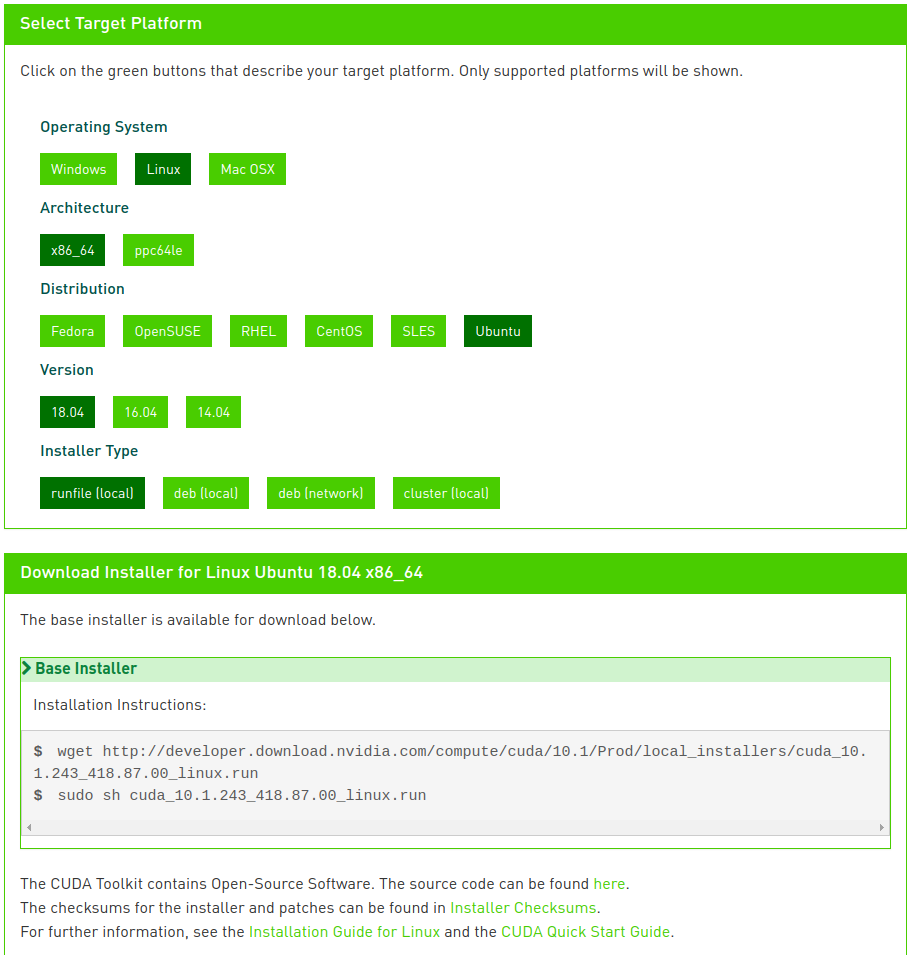

Did a first test of ESRGAN - this went... well, interestingly. An estimate of the CPU only version shows that when capping the number of images per batch for 4 cores, it will take just over 2 months to run once. Not ideal at all. CUDA was needed.

<b>*......Over the next two weeks........*</b>

Reinstalled Ubuntu to remove dependency issues.

Tried to reinstall CUDA, ran into dependency issues with 'build essential' (like before).

Reinstalled Ubuntu (18.04) again, this time, we wiped the USB, and didn't use Netbootin.

Booted the new operating system, and installed build essentials as the first thing, then CUDA as the second thing.

Everything works so far.

Installed Keras, Pip, Anaconda, <a href="https://www.digitalocean.com/community/tutorials/how-to-install-python-3-and-set-up-a-programming-environment-on-ubuntu-18-04-quickstart">virtual environment</a>, Pytorch, <a href="https://github.com/pytorch/vision">TorchVision</a>, <a href="https://github.com/eriklindernoren/PyTorch-GAN">ESRGAN</a>.

Took over 5 attempts trying to download <a href="http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html">the dataset for ESRGAN</a> (Google Drive played up). Make sure to wait until the file is fully downloaded before you try to move the file. The Ubuntu-Firefox combo will let you mess with the files before they're downloaded which can definitely cause issues. I think the issue was fixed by either downloading through Chromium (which makes the download process more obvious as it's not hidden behind the downloads button) or checking that the file was definitely downloaded in Firefox.



<h3>Setting and Running ESRGAN</h3>

Ran ESRGAN for the first time with CUDA. It ran after unzipping the data file and reducing the number of images per batch from 256 to 16, and CPU cores (though I doubt it matters) from 8GB to 4GB. If the reduction step was not introduced, the program would not run as there wouldn't be enough memory to run the code. I also reduced the number of epochs to 5 from 200, but it didn't affect much, as it would have taken 3 1/4 hours per epoch, so I stopped after 1 hour of computation.

Initial parameters (the image shows the original parameters. The circled sections are the parameters that have been changed):

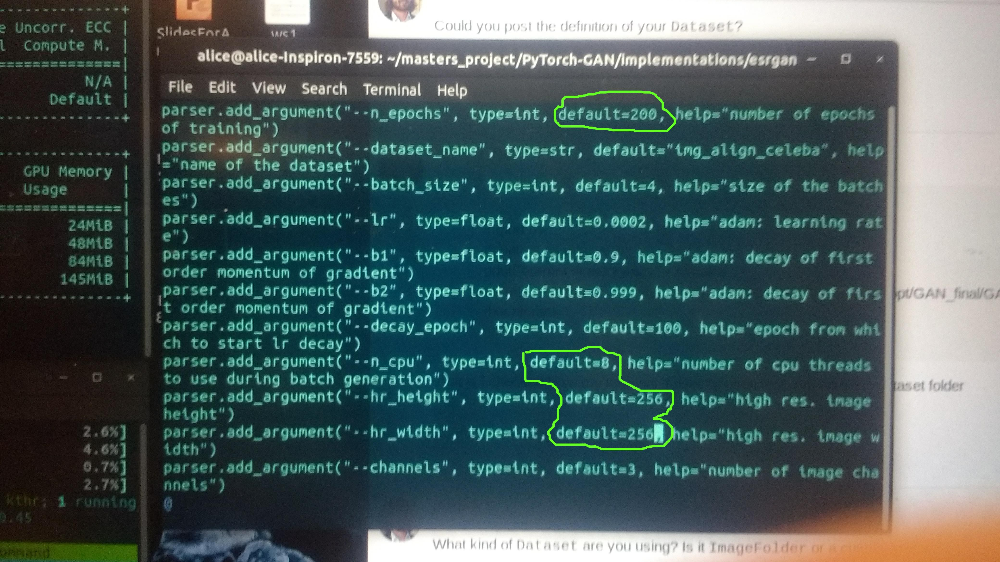


GPU and CPU readings:

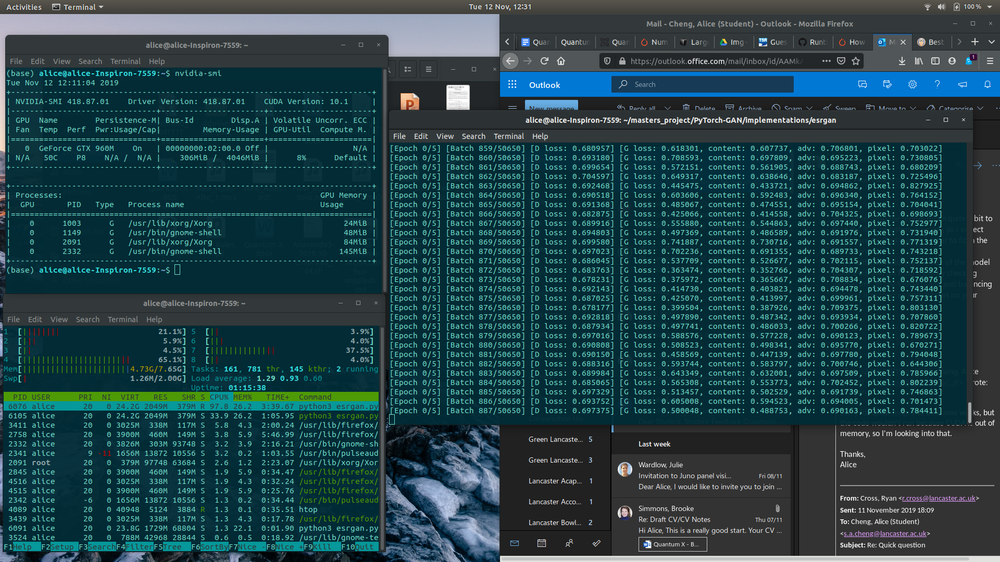

This is a bit ridiculous. So, attempt 2.

After some discussion, it was found that the main reason is because the number of training images were very large (over 100,000). As a result, a smaller training sample size is need - the data we already have is perfect for this.

Used image from <a href="https://astrogeology.usgs.gov/search/map/Moon/Clementine/UVVIS/Lunar_Clementine_UVVIS_750nm_Global_Mosaic_118m_v2">here</a>, and used gen_training.py from my supervisor, I produced 1000 images. If the link doesn't work, the image looks like this:

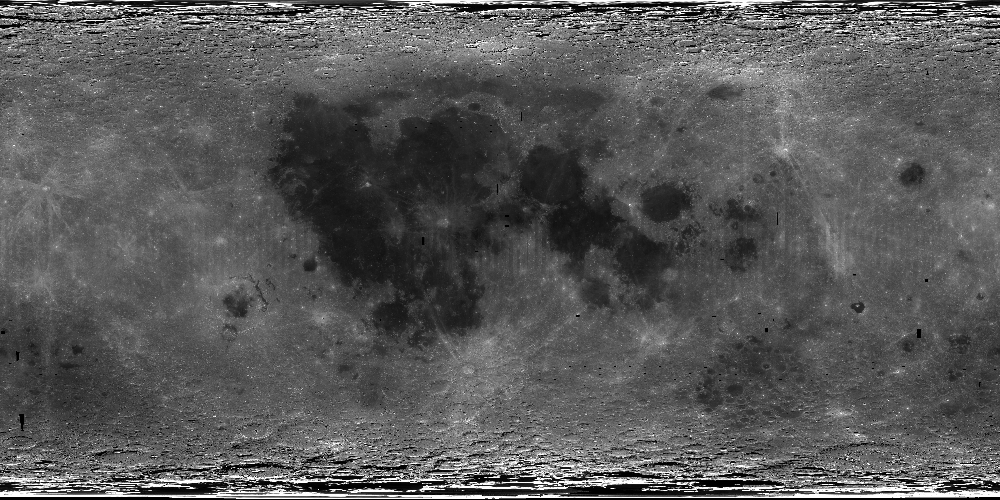

CUDA did not like it (not enough memory).  So after spending a while working out why, the reason came to the batch number. The original batch number was 4, so I just reduced the batch number until I could run ESRGAN on my laptop. This number came to be 1. Phew! According to my flatmate, I'm not the only person that needs to adjust the batch size to run a program, so that's good!!

So the program managed to run at around 1 second per batch (it ran marginally faster with a smaller batch number and, but it went into issues with the colour channels. This is because ESRGAN uses a degree of transfer learning based on the VGG network (I think, **check on me!**), which is trained on RGB values, so it only accepts RGB images. After changing the number of channels in line 46, I found that the program flags an error after ~10 minutes (1 epoch) which is *still to do with the colour channels!!!*. Right, check number two.

After 1-2 hours I asked for some help. The issue didn't come from anything I changed/didn't change, but actually from the VGG network used to train the RDDB part of the generator. The VGG network is trained on colour images, therefore my inputs has to be in colour too.

I thought the fix was complex, but it was pretty simple (literally 2 words). In <code>gen_training.py</code>, add this to obtain RGB images:

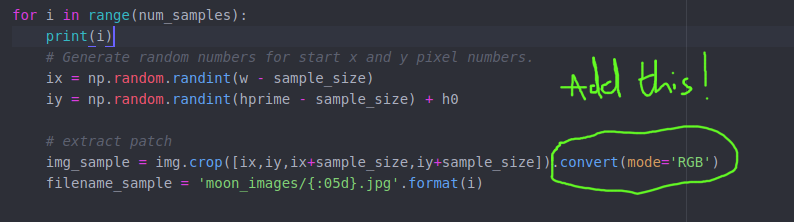

So I ran <code>gen_training.py</code> again, with the following parameters:

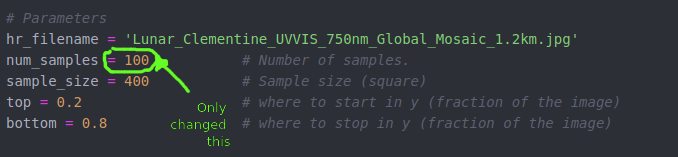

I ran <code>esrgan.py</code> for 100 images for 5 epochs. From timing 5 epochs, it took on average 0.9 seconds per batch (Woohoo!), which means for 80 epochs, it will take 6 hours for about 300 images. Woohoo!!  

Ok, so this is 16/11/19 (Saturday, not that it matters). I managed to produce the first super-resolved (SR) image:

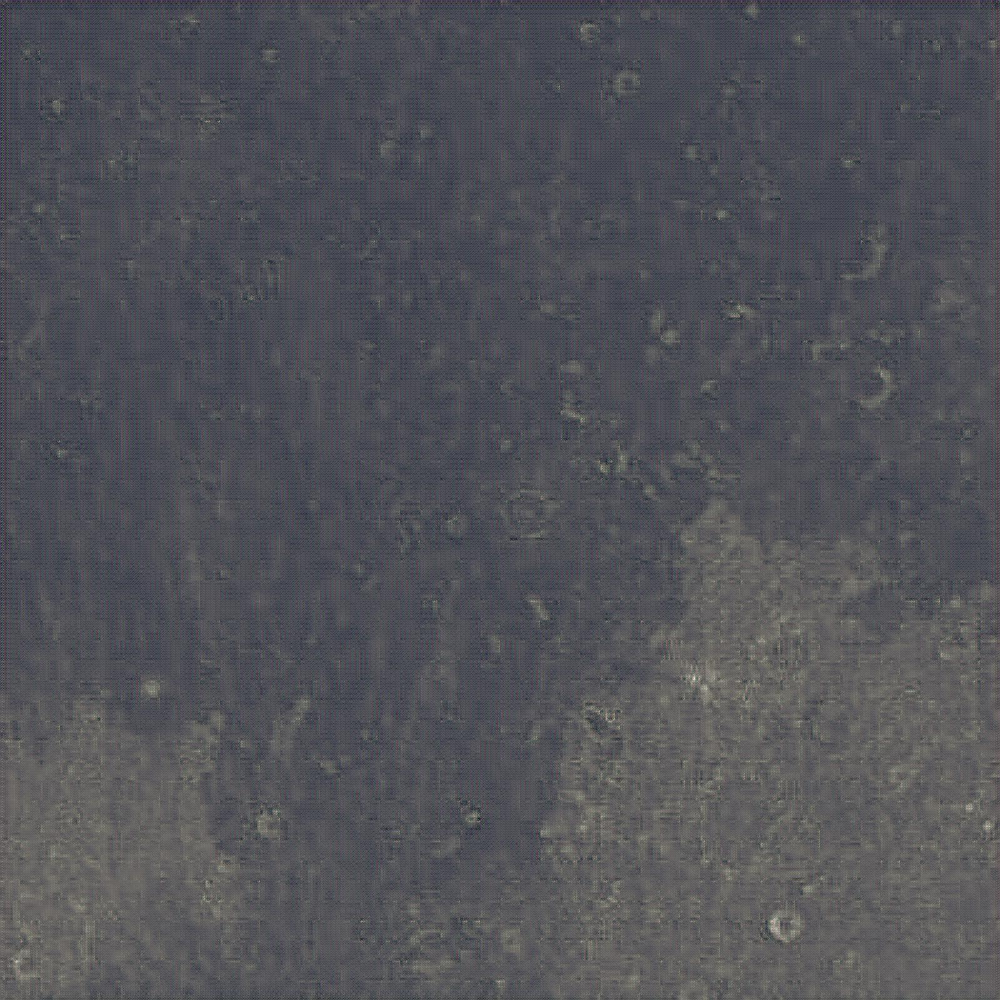

This is the original image:

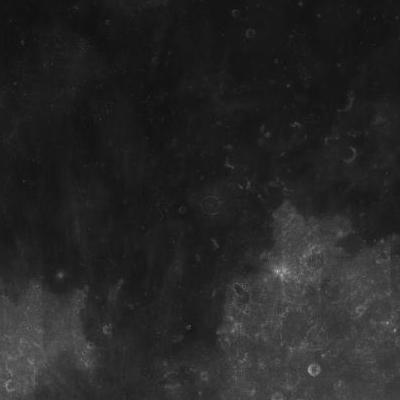

You can see that the SR image is a lot brighter and contains squares of colour, which I assume is caused by the fact that the pre-trained part of ESRGAN is trained on brighter images in full colour (the RDDB part is trained on VGG19). Note that I forgot to downsample the test image, so I'll put the image here once I managed to downsample it.

The parameters used for this were:

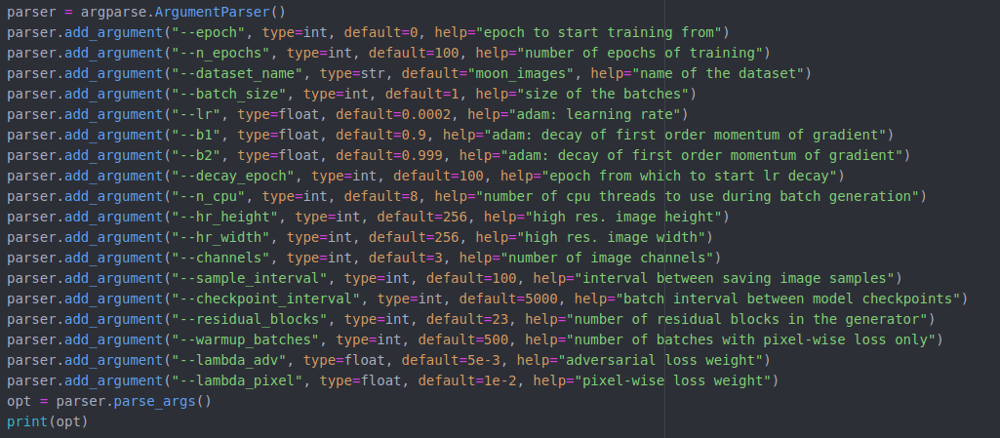

Please note that when you run the <code>test_on_image.py</code> code, you need to input the following:

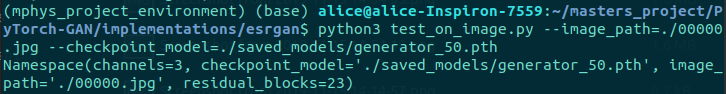

Note that <code>00000.jpg</code> is the name of the test image.

Ok, time for downsampling. Since I don't know which way to downsample the image, I think I'll do both.



<h3>Metrics and Downsampling</h3>

For metrics, I wrote a piece of code to calculate the PSNR and SSIM from the outputs of the super-resolved images and the downsampled images. As both PSNR required the calculation of the MSE, I made the program output the MSE too. **To do: make it so that it's not hardcoded**

The metrics file is actually saved as <code>other_programs/evaluation/psnr_single_img.py</code>. This was because I originally planned to just try out the psnr in the code, but decided I should just put all the metrics in one file. **To do: rename me, and put in a for loop so it works for multiple files.**

The metrics file takes two images, the original image (which is downsampled via the <code>other_programs/downsampling.py</code>), and the SR image, known as <contrast> in the code, as this can be used to compare between any two images, not just a LR and a SR one.

There are 4 functions.The functions <code>mse</code>, <code>psnr</code> and <code>ssim</code> calculates the aforementioned values respectively. The <code>compare_metrics</code> function the plots the MSE and PSNR and SSIM values, giving side by side images for comparison, like the following:

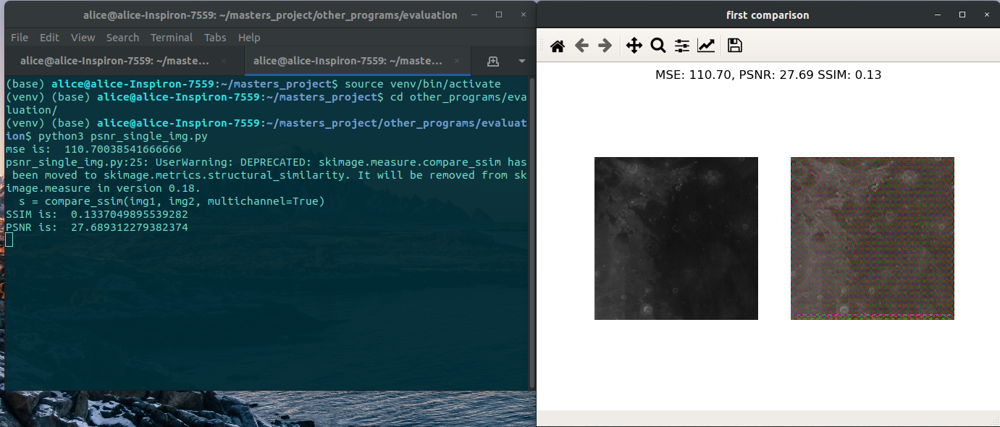

A better look at the output for the metrics:

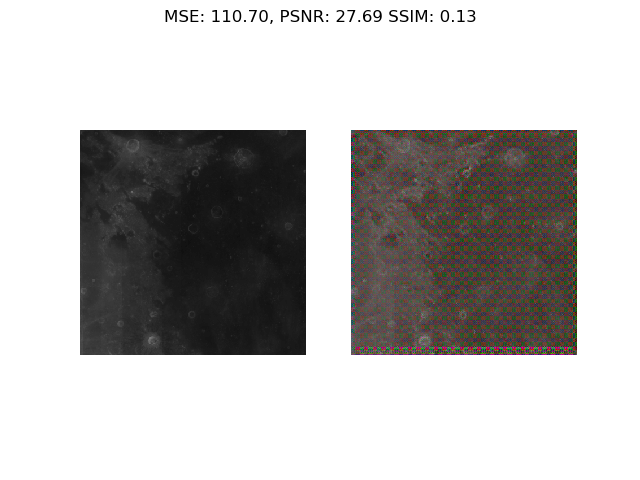


This is still with the ESRGAN image. Which will be discussed in the next section.


<h3>Additional outputs from ESRGAN</h3>

After training ESRGAN under the following parameters:

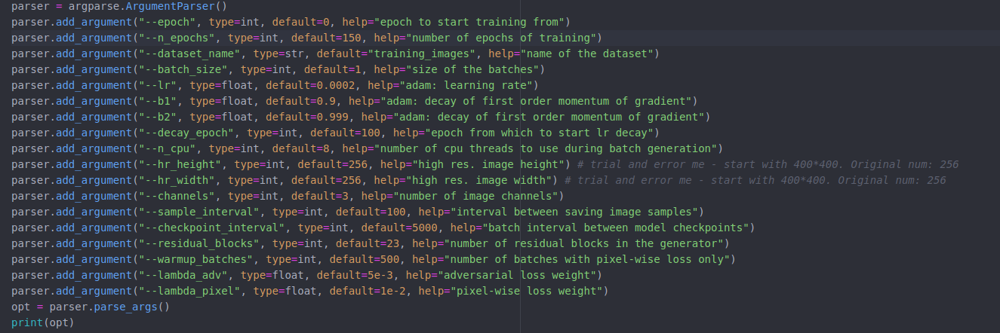

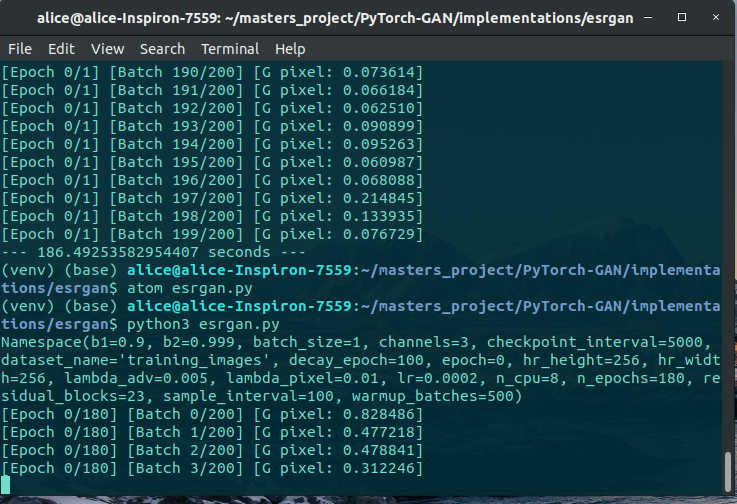

Which produced the following output:

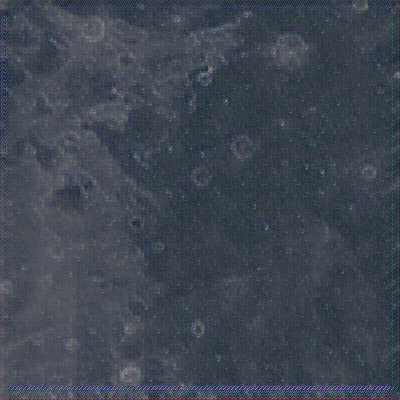

This is the original:

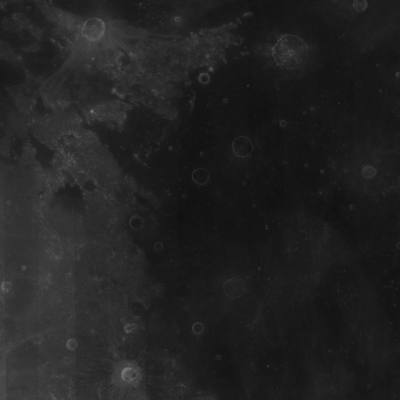

And this is the downsampled image:

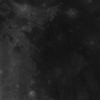

(Same image, just smaller/lower resolution)

This image was speifically chosen as it has both the flat plains and the detailed sections (craters) which gives a good comparison of how well the network deals with the two different features. It was also chosen as it has very distinct bright and dark areas which provided distinct contrast.

One can see the gridded artifacts from this picture,  mostly likely generated as the result of the architecture. The possible reasons behind this can include having the original image been converted into RGB channels, the fact that the RDDB block is trained on the VGG19 dataset. VGG19 is filled with bright coloured photos, taking full advantage of all 3 RGB channels, which is definitely not the case for our network. Another flaw was that the resolution of the super resolved version of the downsampled image does not match that of the ground truth. Note that the original ESRGAN network was trained on 10^5 images, compared to here, where the images were trained on 10^2, thus fully learning is unlikely to take place unless higher powered computers were accessed. There are too many parameters in the code and architecture that can affect the outcome, which meant that it might take longer than the master's project to overcome these issues. After a meeting with Chris, we decided to go with SRCNN instead of ESRGAN.



<h3>SRCNN</h3>

The main program for SRCNN is saved in <code>MoonSRCNN-master/source</code>, while the data is saved in <code>MoonSRCNN-master/dataset</code>. The data needs to be first generated using <code>generate_data.py</code>. You need to input the arguments into the terminal first, or else you get this:

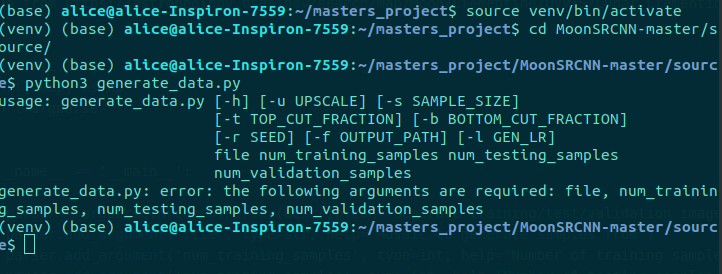

To run this, you need to create the file<code>dataset</code> in the location you inputted here:



and make sure that it has an internal structure like so (or you'll get an error saying file not found for the name of the first image generated), i.e. in this folder:

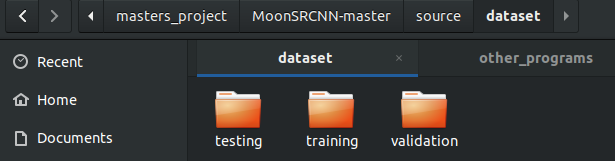

then input the following in the terminal:

* The large image you want to generate the training images from
* A single number for the number of traing, testing and validation samples respectively, as shown in the example below:

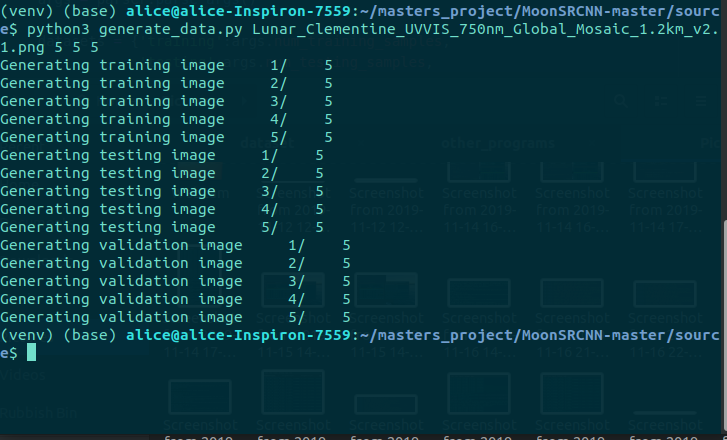

Where in this case, the large image is stored in the same folder as the main code (for ease of generating images and to shorten the time it takes to type the path in the terminal), and that 5 of training, testing and validation images (in their respective orders) are generated.

There are a total of 5 files in source (short description of each as follows): 
* <code>data.py</code> is for processing the training images. In particular, iterate through the images in a given folder, rescaling and domsampling all the images. <code>training.py</code>
* <code>generate_data.py</code> generates the training, validation and testing image reqired. This needs to be ran in conjunction with input parameters in the terminal, as detailed in the previous section.  
* <code>model.py</code> the convolutional neural netowrk model. Contains layers of Conv2D, Relu, Conv2D, ReLU, and Conv2d.
* <code>training.py</code> trains the network, and shows the progress bar. Parameters can be set in the terminal, but is not required.
* <code>validate.py</code> loads the model saved in the same folder as this file (ending in <code>.pth</code>. This is used for making predictions, i.e. actually superresolving the image. Even though it's used for testing, it's called validation as it's also used for the validation data to test and improve the training data.



<h3>Initial output from SRCNN</h3>

Note that the code was heavily influenced by https://github.com/basher666/pytorch_srcnn, and was edited by my supervisor. Before training, I noticed that the learning rate was very high, at 0.01, whereas the most common value would usually be 0.0001 to 0.001, so I changed the learning rate to 0.0001.

This is the loss funcition from training for 80 epochs (which took less than 20 minutes)

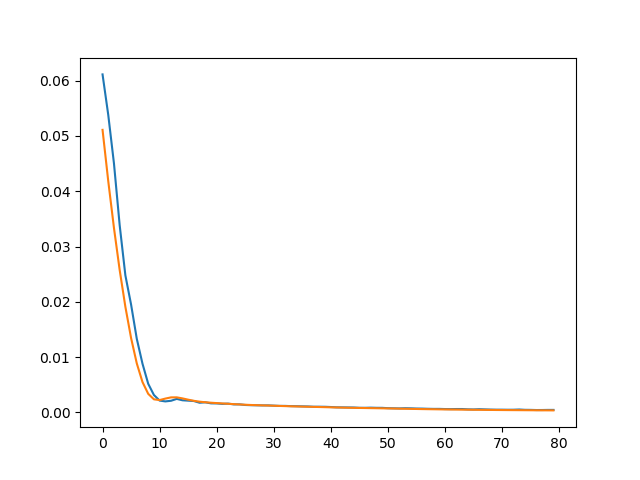


This looks like a normal curve for the loss function, as one can see that the loss function tends towards zero.

(later update: actually, I no longer think this is a normal loss function. There are almost no fluctuations and the result seems to arrive at zero, not just tending towards zero, inferring that there's an issue with the code. See the 'troubleshooting' section later in this doc).

Here's the original image *(image not working - actually, I managed to find it. It was found in the training set of images)*:

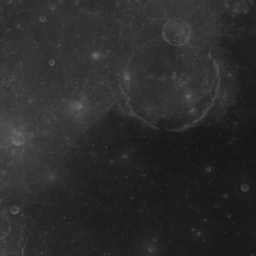

Here's the output from the super resolution algorithm *(image not working due to changing file structures, accidently overwriting the files when producing new datasets, and re-structuring the code in jupyter notebook (jupyter notebook saves the images, but only when it's not moved from its original position in the document). The original and super resolved images are still featured in 'first comparison.png' I could regenerate this image using the regenerated image above and train the network under the same parameters. This could be done in a later time)*:

0007_hr_sr.png

The output is very blurry, which is one of the main issues with non-GAN-based algorithms (though with GANs, the issues are mainly to do with being difficult to train and the production of artifacts from the generator). A possibility is that it's not trained for long enough with not enough data (I trained using 100 images). Nevertheless, after checking the code, I'm suspecting that it's because the training images are very small, 128 by 128, which means most information were not fully captured, hindering learning.

*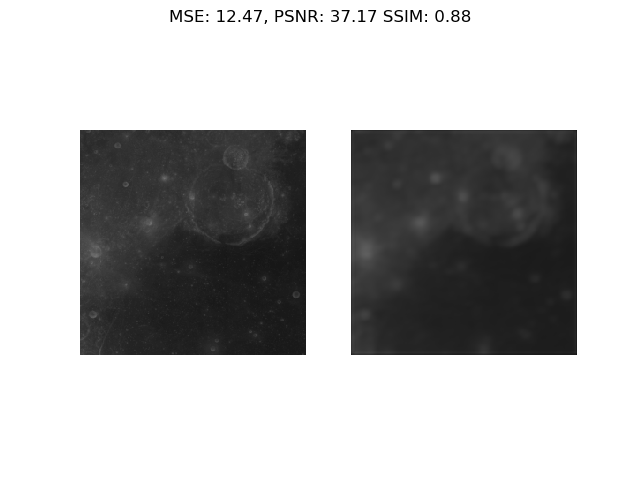*

So, I tried to train the program again using 3000 images (usually a good, though very small sample size for CNNs) and image sample size of 256 by 256.Unfortunately, this froze and spectacularly crashed my laptop (on the lines of the power button failed to respond until 5 minutes later, where the computer finally responded to me cancelling the program). I don't think this program is using the GPU (later I checked with <code>nvidia-smi</code> while the program is training, and there were no GPU usage as shown below), so I'll see how that can be done.

*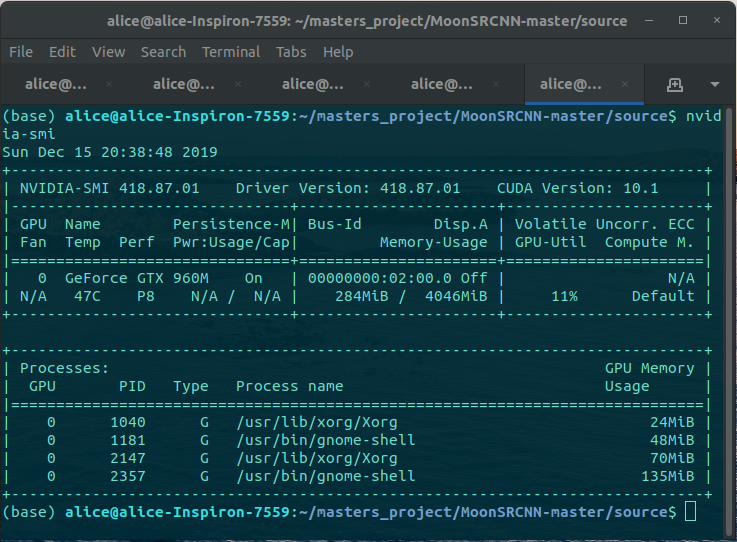*

**To do: work out how to incorporate GPU**

For now, I'm getting the program to run on the CPU (intel i7 should suffice, right?). I reduced the batch size from 64 to 32 such that there is enough memory to run the program. The initial parameters are set like so:

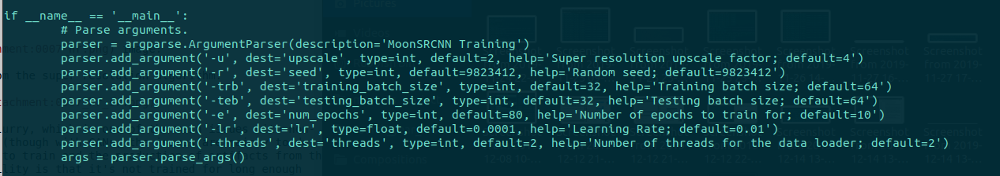

I.e. this has been ran over 80 epochs, batch size is 32, for 3000 images in the training set, as generated by the data generator. Each image has a size of 256 by 256, which is twice the size of the previous training images.  I ran this overnight, but I couldn't get the precise amount of time it takes to run as the line for the time taken was placed after the line for plotting the graph, which meant it notes down the amount of time it takes to both generate the graph for the loss function, and the time it takes for me to noticec the graph and close it. But the upper limit for the time taken should be under 10 hours.

The loss function for it is as follows:

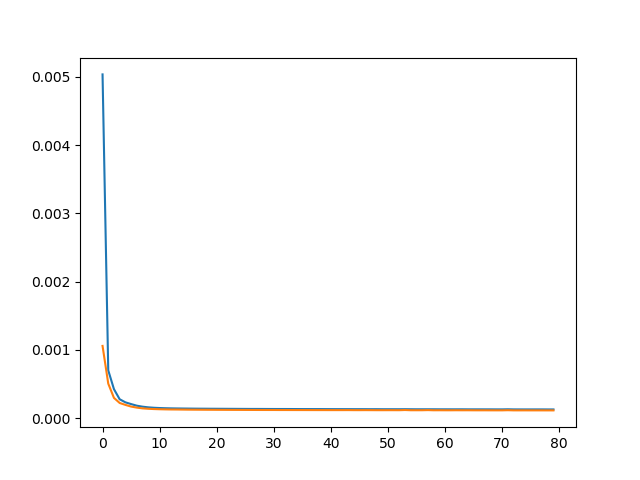


This loss function shows that the function converges after around 10 to 20 epochs, so for the next set of training, one can try much fewer epochs, and many more images.

These are the images, with the metrics on top:

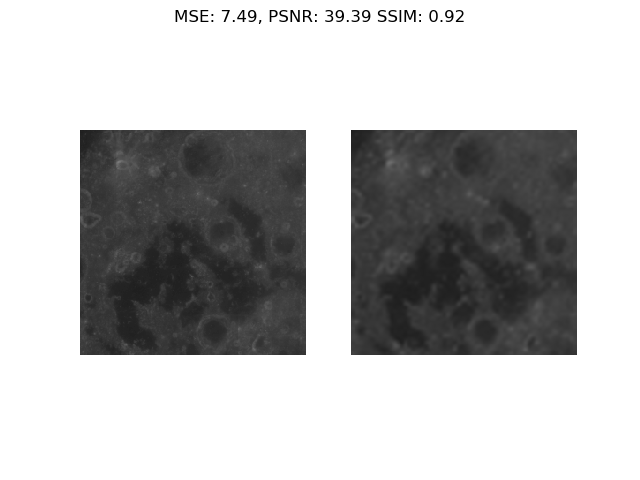

Note that I used the naming convention for the images with *e* as the number of epochs, *b* as the number of batches and *i* as the number of training images used. E.g. 80e_32b_3000i.png means the image for the loss function is from traing over 80 epochs, 32 batches using 3000 images.

Compared to before, the PSNR and SSIM has seen improvement, though not extremely significant, however the MSE has seen a giant improvement. One of the suspicions that has arisen from discussing with my supervisor is  possibly optimising the loss function for the task on hand. **To do:** So I will do this today by researching into papers for better loss functions. I'm also going to run the program with more images, fewer epochs.

The following are the outputs from 12,000 training images, 30 epochs. The total running time is as follows:

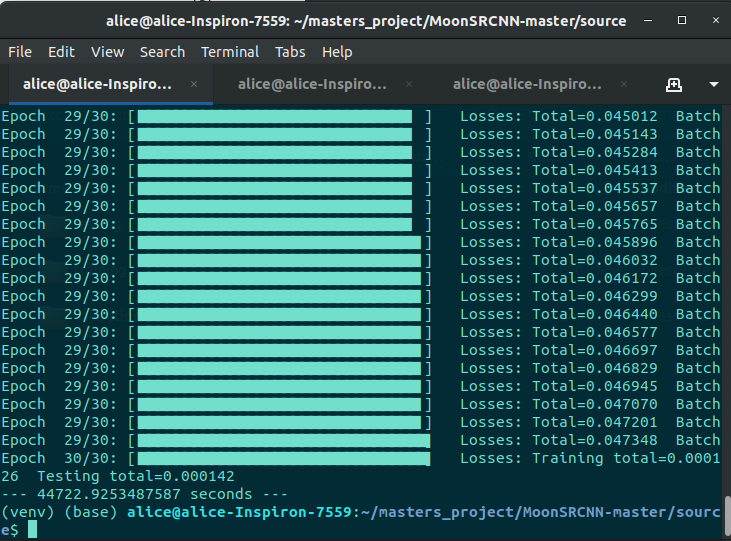

Which is:

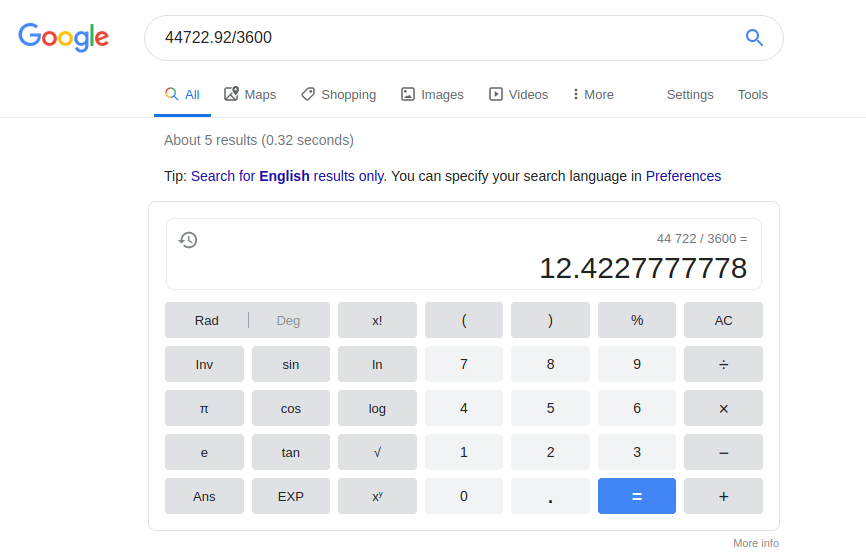

Curiously, the loss function looks like this (too smooth, and falls too fast):

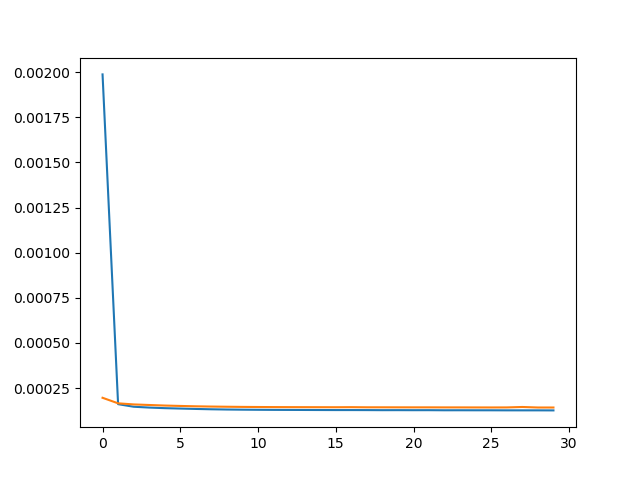

Where the blue is training loss, and the orange is the validation loss. When the validation loss is lower than the training loss, the data is said to be overfitted. Nevertheless, a bigger concern is the fact that the loss function falls straight to zero, which should not happen as loss functions should gradually assymptote towards zero.

What's more, the images produced are still blurry. The original is:

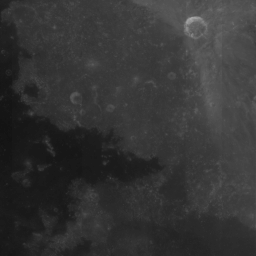

The SR image is:
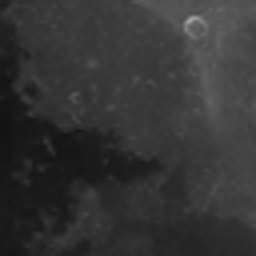

And I'm not sure why. Let's see the metric values:

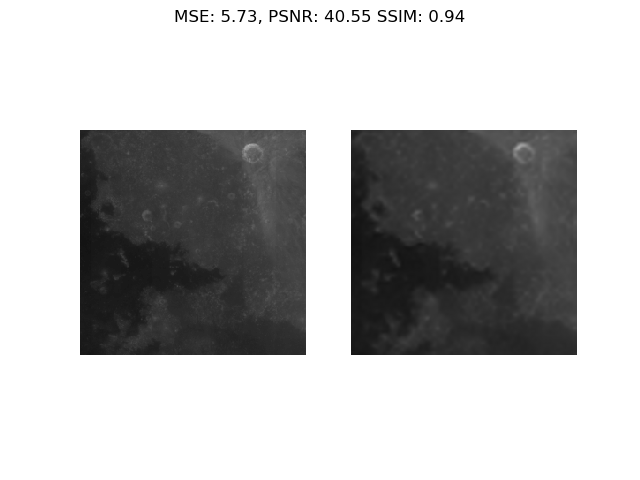


While the MSE is lower still, there is virtually no improvement in the other metrics. Time to see whether changing the loss function will help.


<h3>Troubleshooting</h3>

Seeing that there is no improvement, there could be two main possible causes for this:


* The program is not learning, which can be a sign of an issue with the data, or an issue with the architecture/code itself.

* The program is overfitted - see the first sub bullet point below.

* There is some sort of bug in the code.

Having had another look at the loss functions, I noticed the following problems:

1. The loss functions falls way too fast. In fact, it seems to fall after the same fraction of epochs regardless of the number of epochs used. This should not occur, as  CNNs tend to have a loss function that falls after a set number of epochs depending on the initial parameters set, e.g. falls to below 1 after 30 epochs, not falls below 1 at 1/10 of an arbitrary number of epochs. Normally, one would expect the loss fuction to fall below 1 after at least 10 if not a lot more epochs.
    * This could,  be a sign of overfitting, however, it is unlikely as I got the same results regardless of the amount of training data I used (ranging from 100 to 12000 images, which meant one should see a significant reduction in overfitting from larger dataset).
2. There are no fluctuations in the loss function. Regardless of the step size, there seems to be no fluctuation in the loss function. This is strange because a typical CNN would encounter lots of noise in a real-world dataset, such that a perfectly smooth function would only appear for a perfect dataset. Good examples of the loss functions are shown [here](https://machinelearningmastery.com/how-to-choose-loss-functions-when-training-deep-learning-neural-networks/). Note that the dataset used on this website is likely to be less messy than the real world dataset, and that the only smooth loss function is achieved using logarithmic MSE loss, which is not the case here, as <code>torch.nn.MSELoss()</code> is used in the code here, under <code>training.py</code> line 106.
3. The image *does not super resolve*. At all. If anything, it actually further blurs the image. This was tested with the input image within the code to see if it was the fault of the data sorting code that was playng up. This was because in <code>data.py</code> for SRCNN, the code downsamples, then reupsamples the image using bicubic downsampling. This is because the goal of the network is not to increase the physical dimensions of the image, but to make the test image appear to be more super resolved. As a result, I did some comparison with an image that is manually downsampled then upsampled using bicubic interpolation, and a test image output from the network, the results are below:
    
    * Groundtruth: 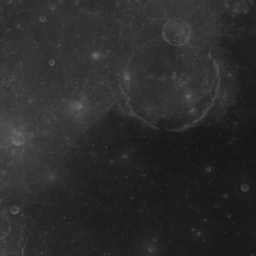
    * Manual bicubic: 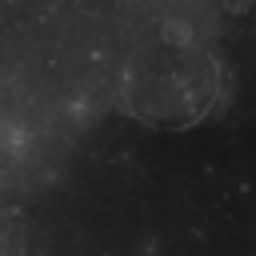  
    * SRCNN: 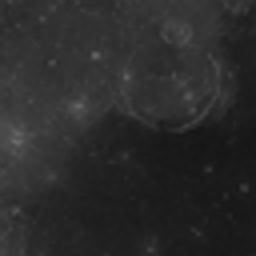
    
    
As one can see, while neither has the resolution of the ground truth image, the image produced from manual bicubic down and upsampling produced similar resolution than that of SRCNN, even after training for 30 epochs for 12000 images. Here's a comparison of their metrics:
* Groundtruth vs Manual bicubic: 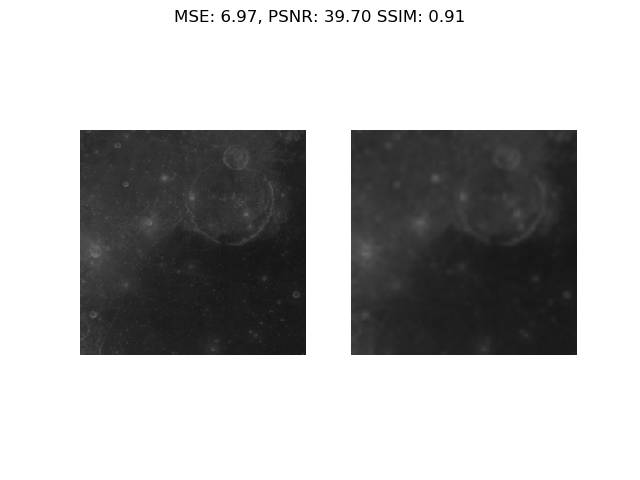
* Groundtruth vs SRCNN: 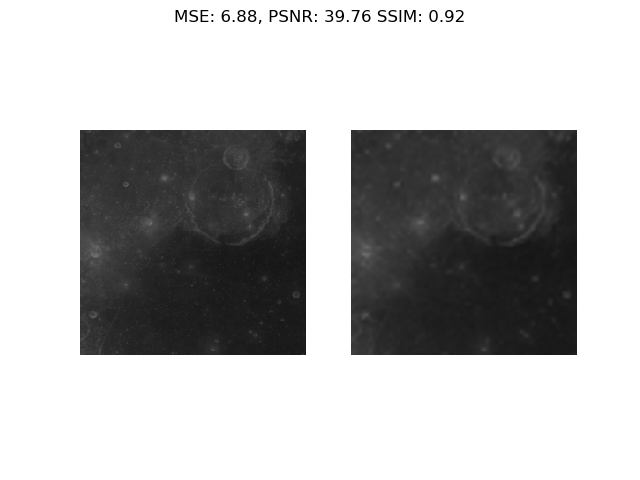

<h3>Bicubic Upsampling</h3>
As an aside, I added the function to generate images from bicubic upsampling (4x higher resolution) into the code <code>generate_data.py</code>, as shown here:

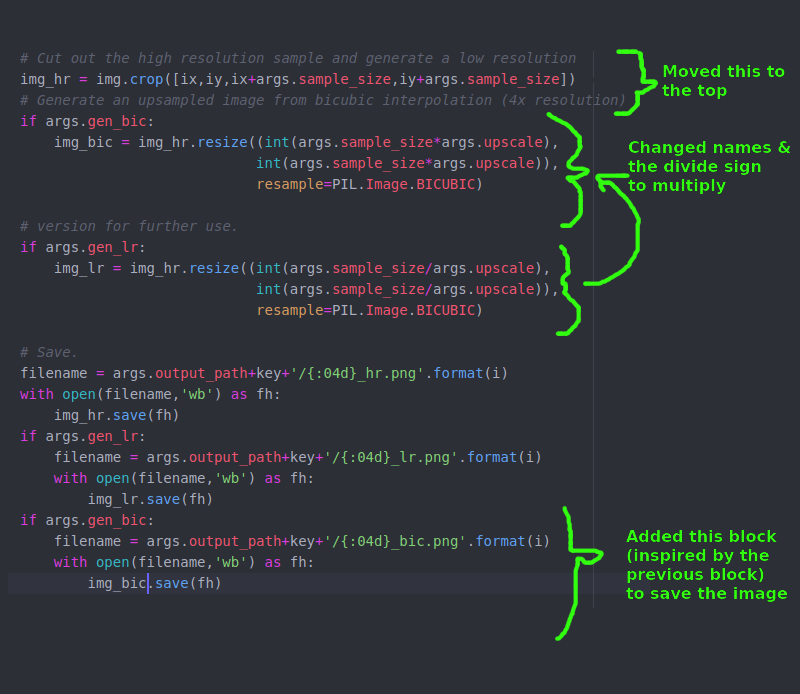

Which meant that, for new generated images, you get something like this:

Original:

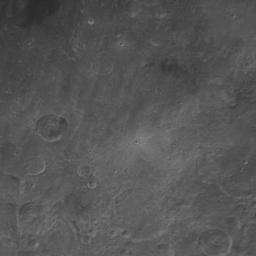

After bicubic upsampling (4x):

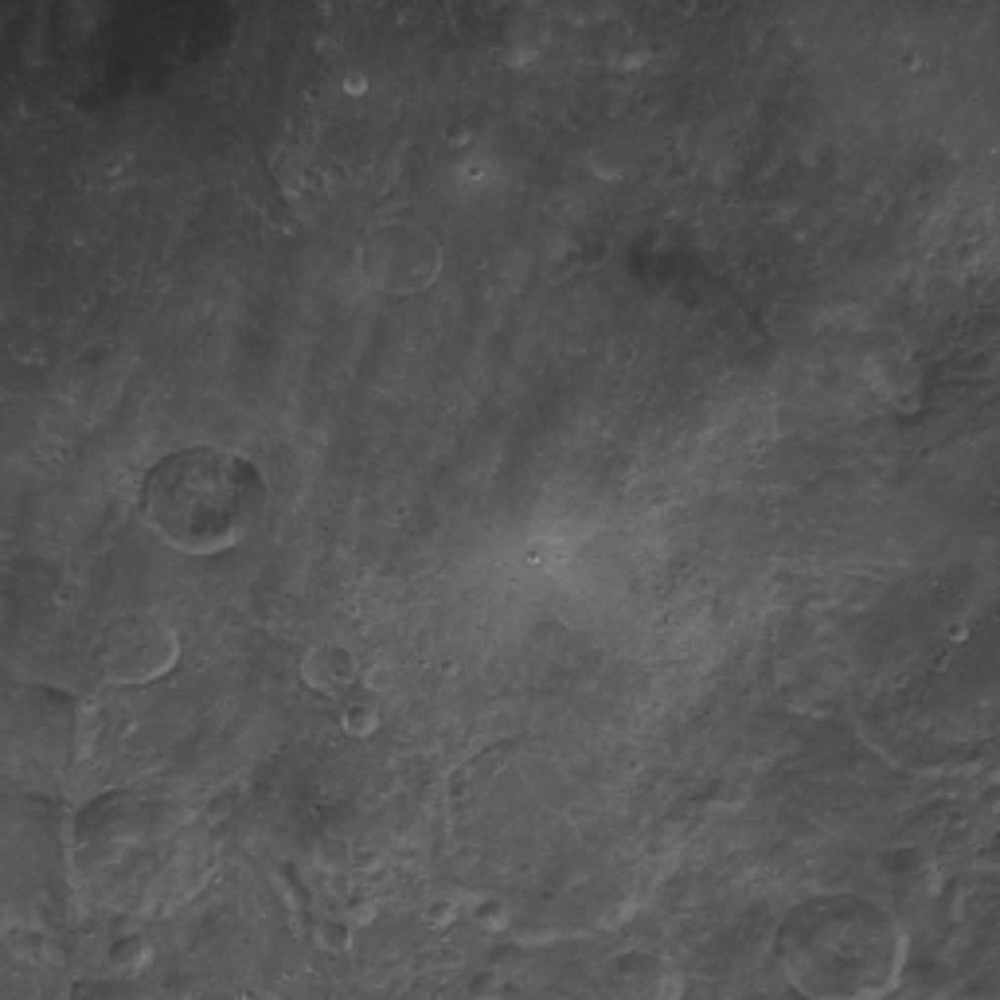

For the separate downsampling then upsampling function, I just copied and pasted the code from <code>data.py</code>:

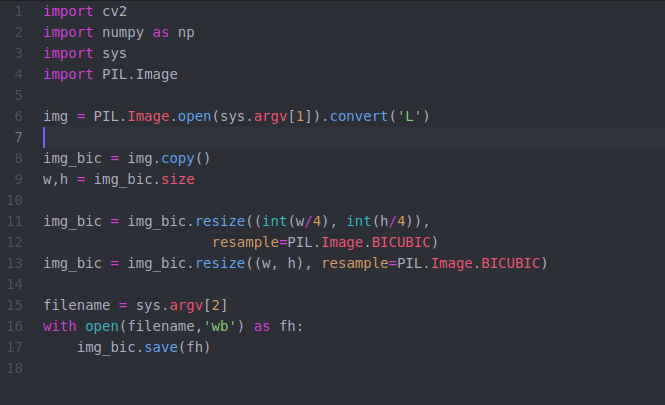



<h3>What Now?</h3>

Since I can't work out what is wrong with the code I've been given (everything seems right, but it just doesn't work, so I'm ending up doing a lot of blackboxing again), I decided to look at a different version of SRCNN. I got this version from [here](https://github.com/yjn870/SRCNN-pytorch). I am happy to switch back once I get a reply, but I might be able to do more with this version while I wait for the reply.

I created a new virtual environment, SRCNN-env, and installed the following according to their requirements:


    * PyTorch 1.0.0
    * Numpy 1.15.4
    * Pillow 5.4.1
    * h5py 2.8.0
    * tqdm 4.30.0 <= as this is just the progress bar, I just installed the latest version, 4.40.2.
    
The issue is I am suspecting that I might have changed the version of the aforementioned modules globally unintentionally, instead of just in the virtual environment. This is because pytorch, Scipy and Matplotlib seemed to be uninstalled when I ran them in a different enviroment. As of now, this should cause any issues, but if there is any issues, just update everything to to the latest version/reinstall to the required version.

To the above: nope, I just unintentionally uninstalled all the stuff globally, but reinstalled each in their virtual environments.

This version of SRCNN was chosen as it has a clear documentation, and has provided test datasets as well as pretrained weights. It is also more closely based on the original paper, [Image Super-Resolution Using Deep Convolutional Networks](https://arxiv.org/abs/1501.00092), with some changes as stated in its <code>README.md</code>. Unlike the previous version, it utilises the module <code>cudnn</code>, which means it utilises CUDA, and thus the network will train on the GPU instead of the CPU, so the results will be obtained faster.

This version also has a similar network structure to the previous version of SRCNN, as both contain 3  convolutional layers and the same number of  as shown:

* Previous version:

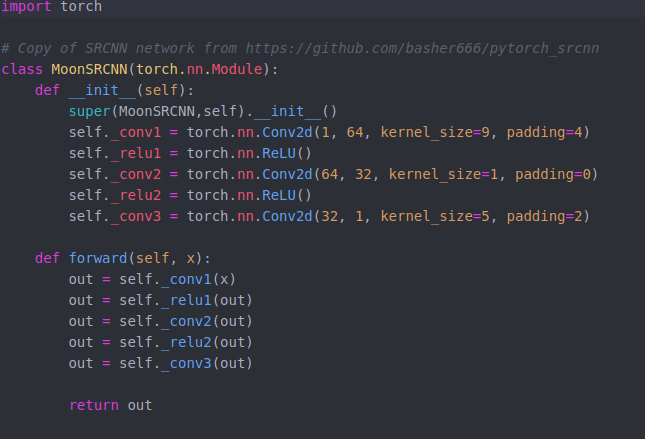

* New version:

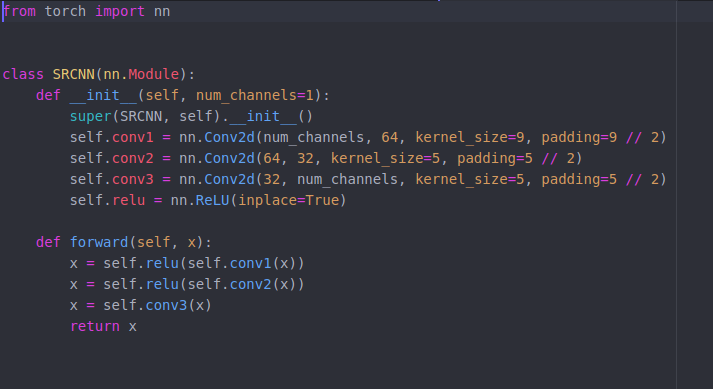

The main difference between the two networks are that the latter has one less activation function (ReLU) in the <code>__init__</code> section, and that the second part only contains <code>conv3</code>, instead of <code>conv1</code>, <code>conv2</code> and <code>conv3</code>. This can be easily reimplemented later on, however, it's good to see how well the code performs under the dataset the moon datasets with its original weights:
Ground Truth:
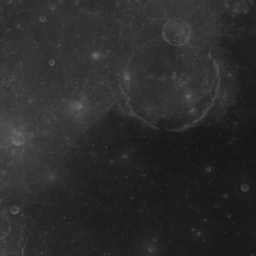

Output (SRCNN yjn870):
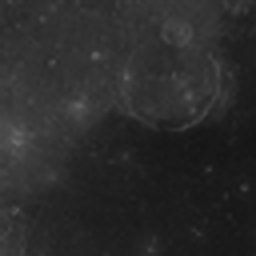

Metric Comparison:
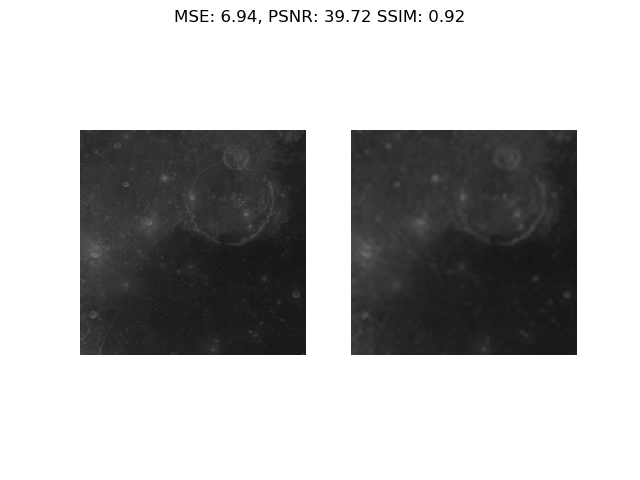

From first run - no significant improvement compared to the previous version. But this is before trainin with the moon dataset. So let's train this.



<h4>Troubleshooting</h4>

For this version of SRCNN, the training files has to be ran through <code>prepare.py</code> to output the images as a <code>.h5</code> format. The <code>.h5</code> is the extension for HDF5 files, which stores data at a very low level, and in turn lets one store huge amounts of data in a single, managable sized file for easy manipulation. The link for the project is [here](https://www.h5py.org/).

So why issues? The code that converts the folder full of images into the <code>.h5</code>  format is not working and I don't know why. When I applied it to 12000 images yesterday, the computer froze completely.  I left it running for around 7 hours and killed it off afterwards, as the terminal was not giving any outputs.

So I tried again next day but with a smaller dataset:


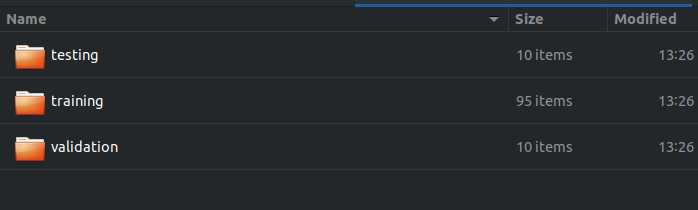

<code>prepare.py</code> managed to run which is good, but it took a while to get the generated <code>.h5</code> files working well with the <code>training.py</code> code. Here's the code for <code>prepare.py</code> that got the training set:

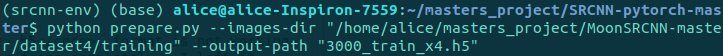

So you need the path to the input directory (best practice is to copy the full path into the terminal, or else you'll run into issues and the errors will not be helpful), then the path to the output file (i.e. the name and location of the file), which can be generated with this code:

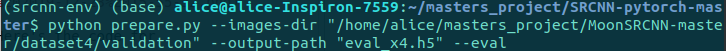

Again, you need the path to the input directory and the path to the output file (and again, check that the data in those directories exist and are the ones you wanted), but also notice that for the evaluation set, you need to state <code>--eval</code> or it will count as training file for the training code, such that an error will be flagged in the terminal, stating that the evaluation file does not exist. Here is an example from <code>training.py</code> for the case when either of the <code>.h5</code> files are not what they should be:

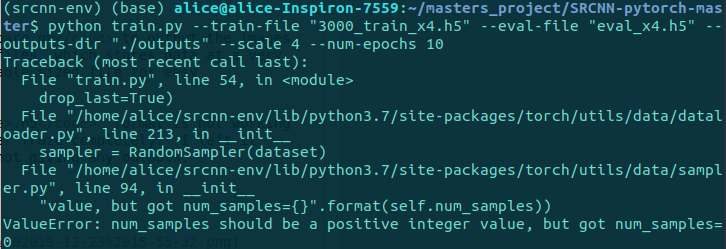


When this occurs, it's likely that either or both of the <code>.h5</code> files are not generated properly.

I then trained the network over 10 epochs as a test (note that this version of SRCNN does not generate a loss function graph, which will be my next task <= **To do**). The terminal inputs and outputs are as follows:

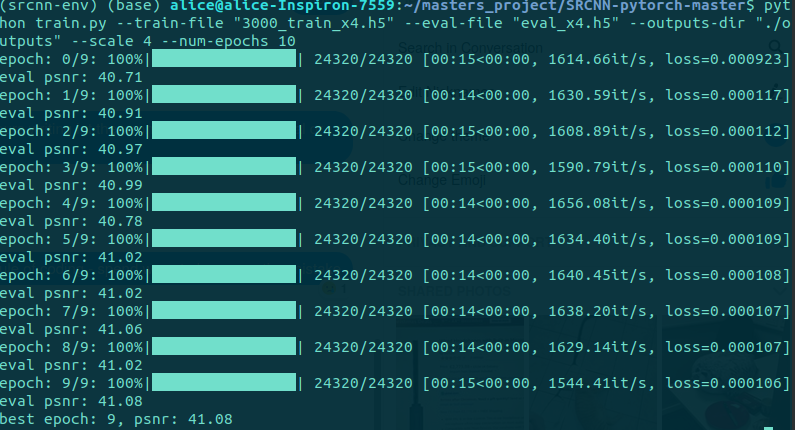

As one can see, the program saves a version of the weights after every epoch, then tells you the best epoch. This means that you can run the program for a large number of epochs without worrying about whether it was the best epoch or not. As a result, **To do** I will need to run this program over a large number of epochs overnight.

Here are the terminal input and output for this training run:

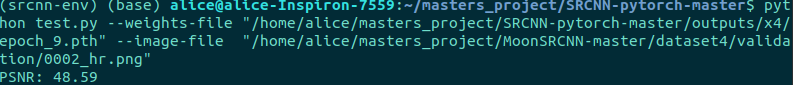

The output images are saved in the same directory as that of the input image for <code>test.py</code>.

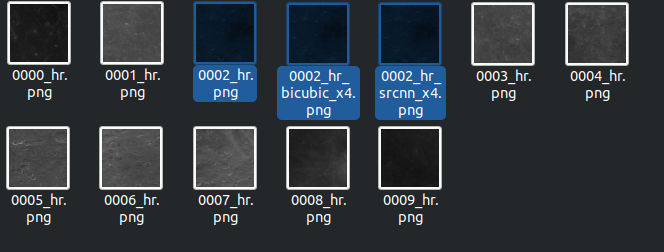

Note that the code also generates a lr bicubic image for comparison. This would be the input image that required super resolution.

So ground truth:

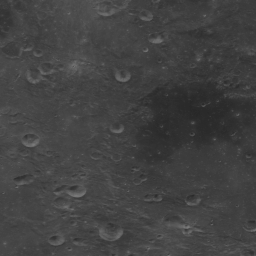


bicubic downsampled image:

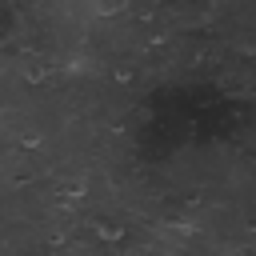         


SRCNN x4 image:

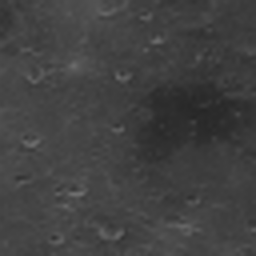


One can see an improvement from the downsampled bicubic image compared to the upscaled SRCNN image.

For ease of running the code, I made a copy of <code>generate_data.py</code> and <code>metrics_compare.py</code>. The comparison metrics between the SRCNN x4 image and the groundtruth image are as follows:

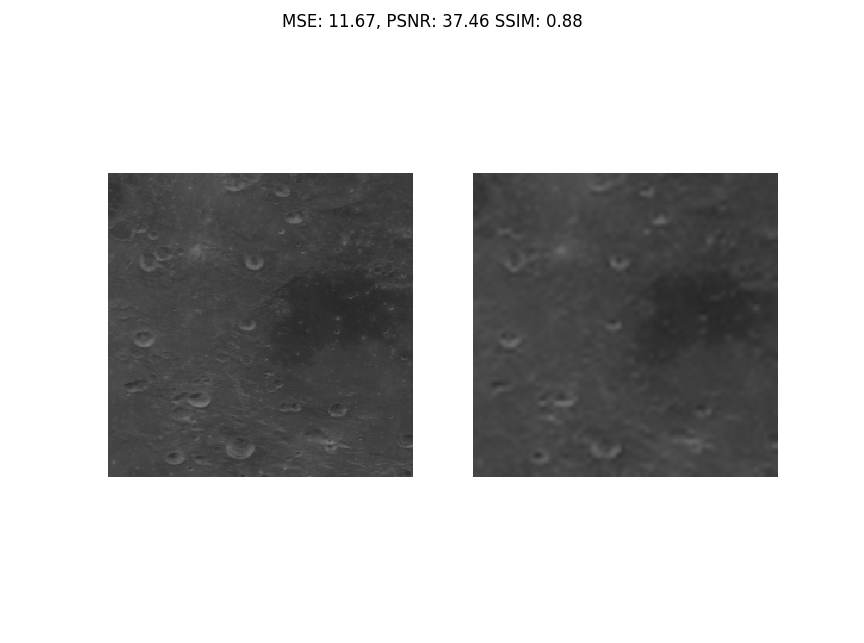

What is interesting is that the PSNR value in the terminal does not agree with the one from <code>metrics_compare.py</code>


I tried running the code for 300 epochs to check if the program runs smoothly over a full training period. The output graph of losses and PSNR looks like this:

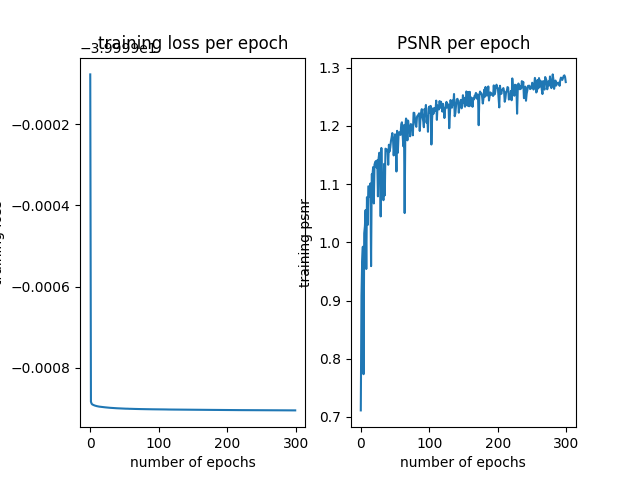

The loss function still looks suspicious - it is decreasing too fast like the previous version. The PSNR graph suggested that the network could be ran for longer. I had a look at the downsampled bicubic image, the original, and the predicted images:

bicubic:
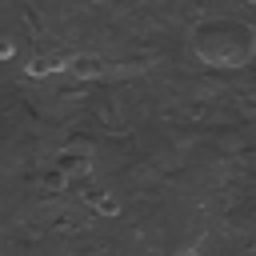

groundtruth:
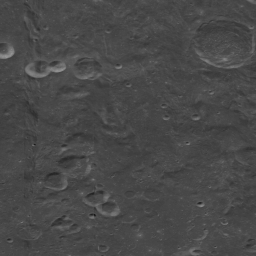

srcnn:
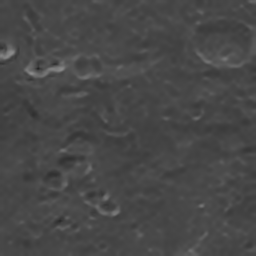

Same shaped graph. I then ran it for 10 epochs (to have a more zoomed in graph and to double check the graph for the first run from this version) to see if the drop was indeed gradual or very sudden, and if sudden, at which epoch did this occur at, and it looks like this:

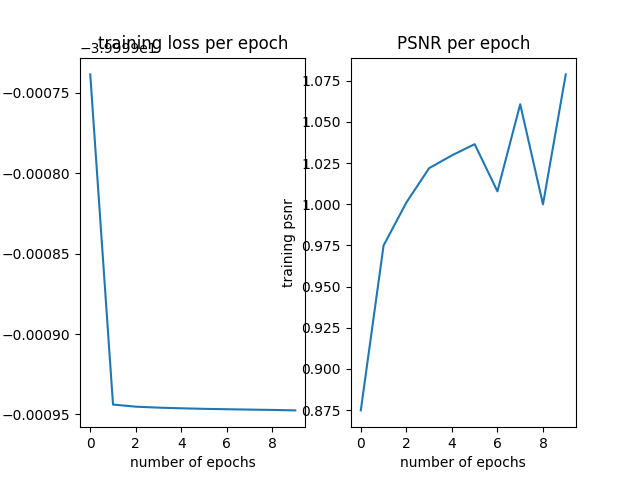

I then tried again with further training to check if this was an one-off issue. This was ran for 400 epochs, partially to see how long 400 epochs would take. I also changed

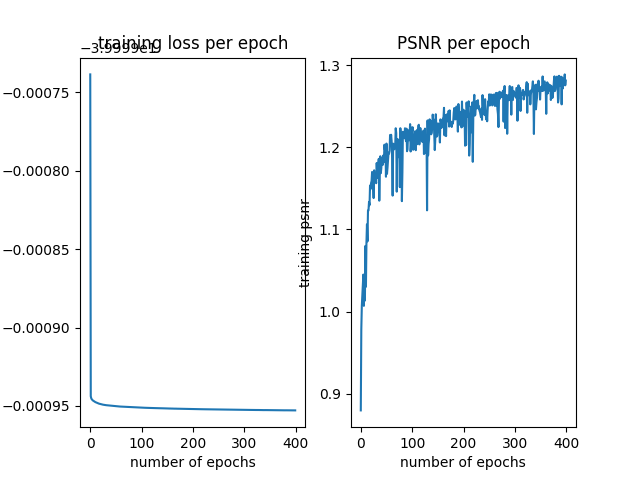


***************Problem might be to do  with the dataset - both versions of SRCNN drops to almost zero after the first epoch - need to implement the validation loss to test for overfitting. then test for issues with the optimiser - i.e. try something like SGD with momentum to see if this is the case, also test with different learning rate. After you sort the loss function issue, start optimising the network architecture to enhance edge detection - can look into achitctures while you wait for reply*****************

Tried with SGD (as the last two pictures were ran using SGD). There were no difference.


As a result, the aim right now is to look into different architectures that can pick out low level features. The reason for this is because it's suspected that conventional super resolution algorithms looks at more abstract, 'obvious', features, such as a facial feature, a building etc, with very original high resolution and high levels of contrast, and often, high levels of colour saturation, thus the RGB values would be different in one region compared to another. This is because the main application of super resolution is used for enhancing everyday images and for the usse in video games. In reality, the dataset used here are the exact opposite - low levels of contrast, and the shapes are, in comparison, arbitrary. Most shapes are almost random, with the only commonality being the craters, as these are often circular. Therefore by tailoring the algorithms to match lower level details, there could potentially be some improvement.


!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

But first, there are a few things to run to make sure other parameters are accounted for, each requires a test run:

* increase image size
* decreasing the patch size
* find the PSNR after bicubic 2 downsampling then and 2 upsampling fo comparison
* implement validation loss to check for overfitting

!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
    
To explore different architectures, I need to look into addition paper with regards to super resolution for low level details.
    

**Decreasing the Patch Size**

Since the original code had the default patch size as follows:

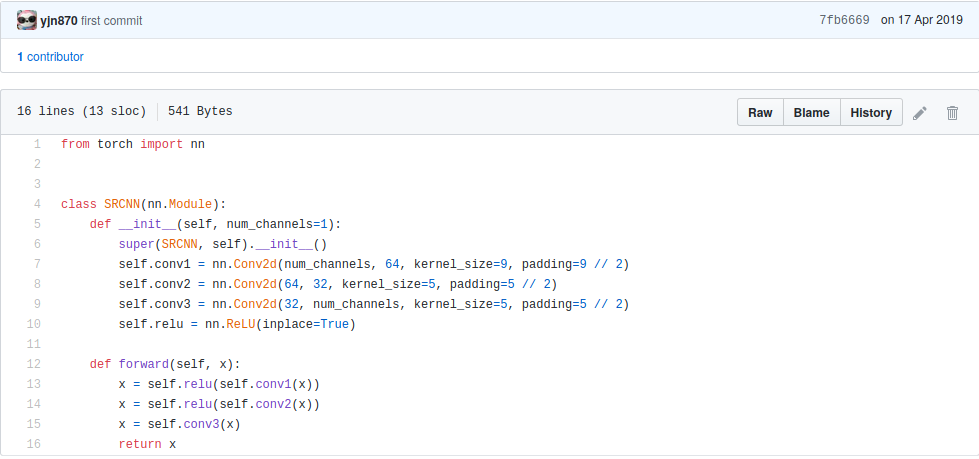

Usually, the patch sizes I see in a CNN is between 2x2 and 5x5, where 3x3 is most commonly used, so the kernels/patches as parameters in this looks too large.

As a result, I changed the kernel sizes to as follows:

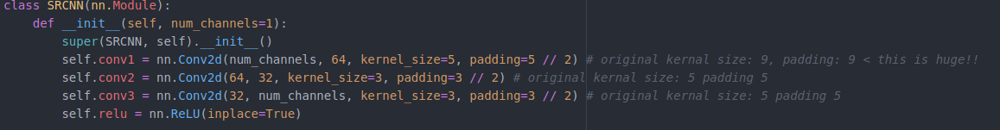

Note that the number for padding must be the integer division of the kernel size divided by two, otherwise, errors will be produced, similar to this one:

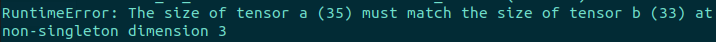

From previous runs of the network (as shown before) the network tends to stop learning very quickly due to the simplicity of the architecture. From prior experience, simple networks stops learning after around 100 epochs so I settled for 80 epochs. 

The training results for the PSNR and the loss function are as follows:

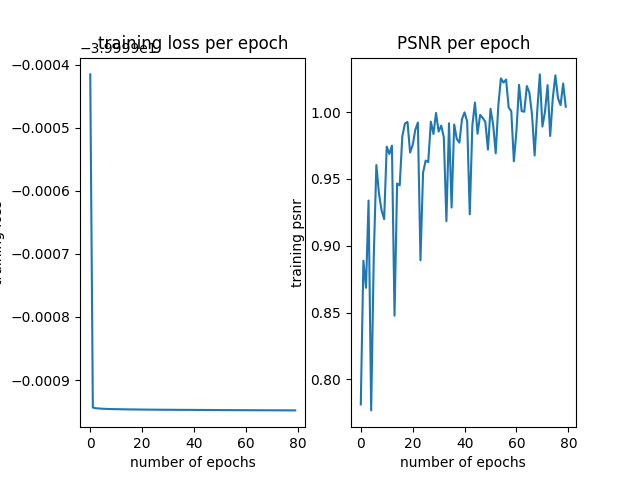

One can see that the loss function is staying the same as before - if anything, it may have been worse as the loss function seems to drop straight to zero. The PSNR values are now fluctuating a lot more, inferring that the network is less stable.

So, patch size definitely does not help. I will change the kernel sizes back to the defaults.

**Changing the scale for resizing**

For a fair comparison to ESRGAN, I originally changed the rescale size to 4x rescale, while the default is 3x rescale. I wanted to see if the rescaling factor made any difference (I don't think it should).

From the first epoch, you can see that the loss is still very small, as shown:

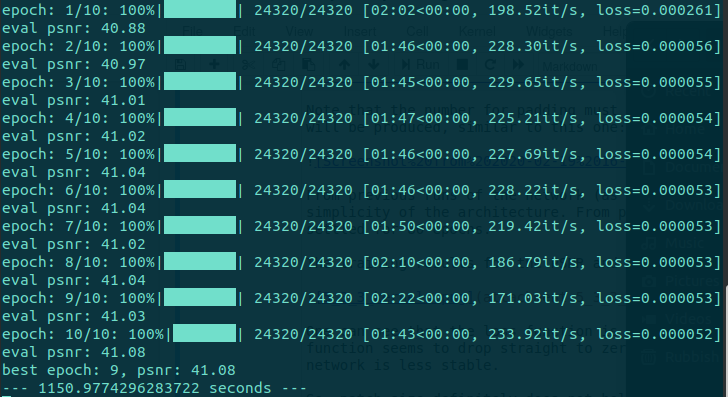

which means the scale is not the cause of the problem. This is its graph after 10 epochs:

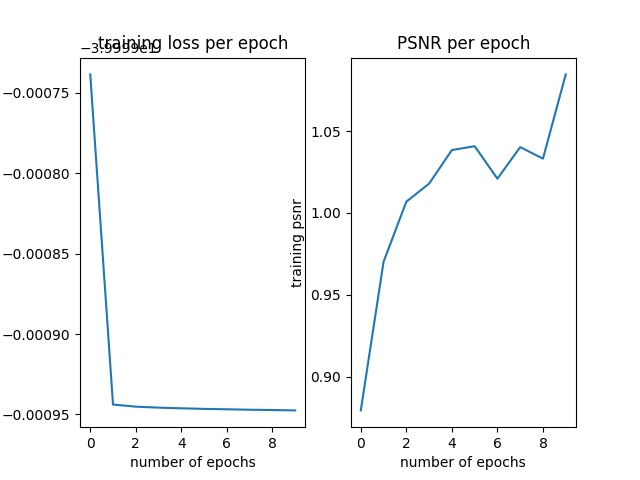

As one can see, the loss function has droped extremely close to zero, which agrees with my hypothesis.

**Double checking the data file**

Due to the fact that the program has a data processing file, I'm curious as to whether the lack of learning was caused by the corruption/incorrect coding of the data file. As a result, I will do two things, one is to make another data file with the current settings and the other is to make another data file but with bigger images.

While checking the data file, I realised that, for the folder for training images whiich contained what I thought of as 3000 images, it actually contained 95. T meaning I may have forgotten to undo the changes after a testin phase. I'm now going to create a training file with 12000 images to see if this is the cause.

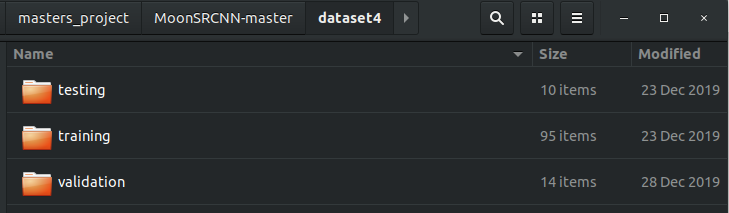

Issue with the above: 12000 images is too large and crashed my laptop.

Trying again with 6000. To do  this, I made a backup copy of the folder 'training' in dataset 2, and copied the first 6000 images to a new training folder, under 'dataset5'. To move the first or last number of files to a new directory a, or b, you use the following:

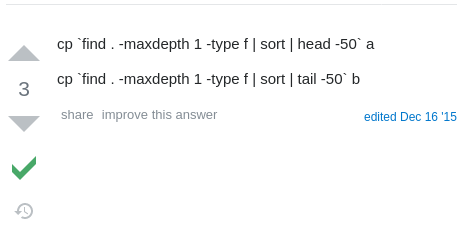

Here's the link if you want to copy the command: https://stackoverflow.com/questions/34250014/how-to-copy-some-number-of-files-from-one-directory-to-another-with-cp-command

I.e. a or b are the directories you want to move to. This command assumes you're already in the directory  that you want to copy from. If not, change the '<code>find . </code>' to '<code>find insert/your/source/directory/ </code>'.   

For 6000 images: my laptop still crashed.

So, onto 3000 images. I did the same thing as the 6000 images (copying the first 3000 images from <code>dataset2/training/</code> etc.) but strangely, it produced this:

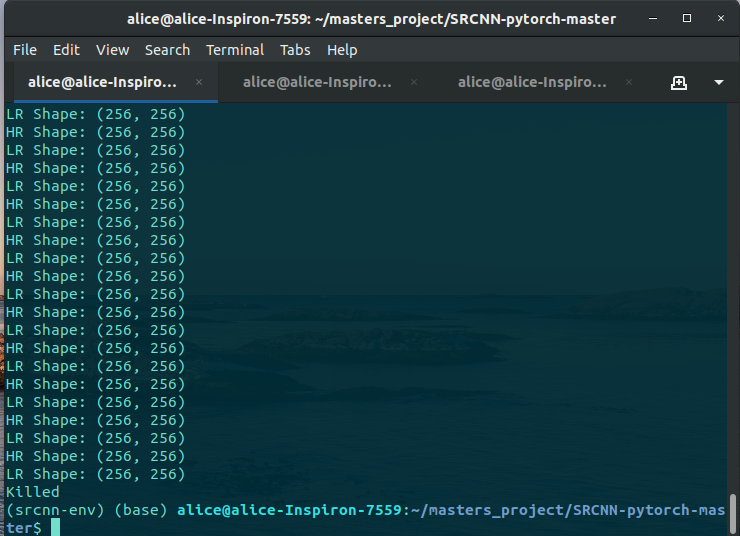

The program was killed at the end. I searched the original program for the word 'killed' in case it was some sort of exception handling, but the word wasn't present. I tried to train the network on the new, albeit killed datafile and it gave an error:

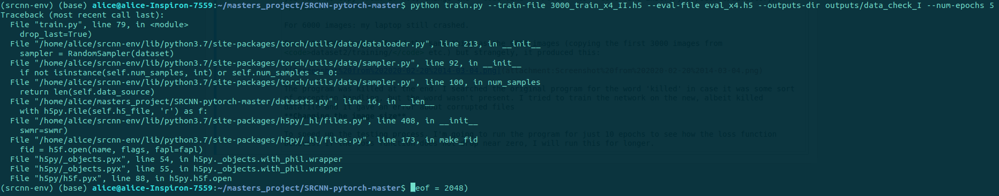

Which tells me that there's an issue with the compressed datafile.

Upon Googling, this seems to be the cause:

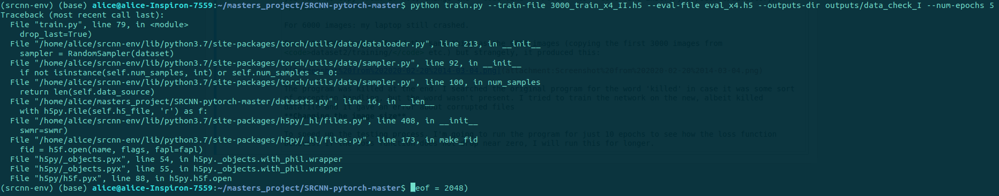

I.e. my computer doesn't have the resources. This doesn't make sense, because an iMac with less memory and an i5 core can process 24000 images for a neural network (albeit slowly) without crashing or giving errors. I'm starting to think that this issue has a link to my operating system? (Partially because, on a slightly unrelated note, lots of games that was linux compatible seems to crash badly on my laptop in Ubuntu, but runs perfectly fine on Windows, even though the system requirements are the same).

**Changing the image size**

To speed up the testing process, I'm going to run the program for just 10 epochs to see how the loss function behaves. If the loss function does not drop near zero, I will run this for longer.